<a href="https://colab.research.google.com/github/OiAb/SpeakerDiarization/blob/main/SpeakerDiarization_Vib3s.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Installations et importations

In [1]:
!pip install -q pyannote.audio==1.1
!pip install pafy
!pip install youtube-dl
!pip install resemblyzer
!pip install pydub
!wget -q http://groups.inf.ed.ac.uk/ami/AMICorpusMirror/amicorpus/ES2004a/audio/ES2004a.Mix-Headset.wav
!wget -q https://raw.githubusercontent.com/pyannote/pyannote-audio/master/tutorials/data_preparation/AMI/MixHeadset.test.rttm

     |████████████████████████████████| 230 kB 5.4 MB/s 
     |████████████████████████████████| 59 kB 6.8 MB/s 
     |████████████████████████████████| 49 kB 5.6 MB/s 
     |████████████████████████████████| 41 kB 225 kB/s 
     |████████████████████████████████| 130 kB 44.3 MB/s 
     |████████████████████████████████| 308 kB 41.2 MB/s 
     |████████████████████████████████| 209 kB 45.8 MB/s 
     |████████████████████████████████| 80 kB 8.7 MB/s 
     |████████████████████████████████| 75 kB 4.3 MB/s 
     |████████████████████████████████| 149 kB 47.2 MB/s 
     |████████████████████████████████| 112 kB 47.5 MB/s 
     |████████████████████████████████| 49 kB 6.0 MB/s 
     |████████████████████████████████| 1.9 MB 5.3 MB/s 
     |████████████████████████████████| 15.7 MB 4.9 MB/s 
     |████████████████████████████████| 78 kB 6.6 MB/s 
     |████████████████████████████████| 66 kB 3.9 MB/s 
  Created wheel for webrtcvad: filename=webrtcvad-2.0.10-cp37-cp37m-linux_x86_64.whl size=

In [29]:
%matplotlib inline
from pyannote.database.util import load_rttm
from resemblyzer import preprocess_wav, VoiceEncoder
from pathlib import Path
import pafy 
import youtube_dl
import torch 
from torch import nn
import torchaudio 
from torchsummary import summary
from torch.utils.data import Dataset,DataLoader
import numpy as numpy
import os
import subprocess
import tqdm as tqdm
import json
from pyannote.core import Segment, notebook
from IPython.display import Audio
import librosa
import librosa.display
import IPython.display as ipd
from pyannote.audio.features import RawAudio
from pyannote.metrics.diarization import DiarizationErrorRate
from pydub import AudioSegment

## AMI annotated data


In [35]:
DEMO_FILE = {'uri': 'ES2004a.Mix-Headset', 'audio': '/content/ES2004a.Mix-Headset.wav'}

Visualizing the expected output of the speaker diarization pipeline with pyannote.core.

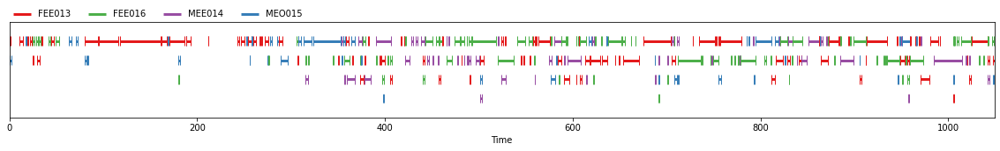

In [4]:
# load groundtruth
groundtruth = load_rttm('/content/MixHeadset.test.rttm')[DEMO_FILE['uri']]

# visualize groundtruth
groundtruth

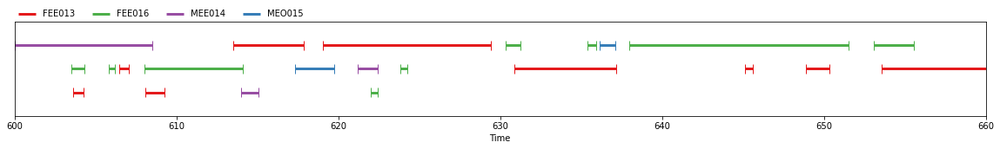

In [5]:
# make notebook visualization zoom on 600s < t < 660s time range
EXCERPT = Segment(600, 660)
notebook.crop = EXCERPT

# visualize excerpt groundtruth
groundtruth

In [6]:
waveform, sample_rate = torchaudio.load(DEMO_FILE['audio'])
print("Stereo signal -> waveform shape: ", waveform.shape)
waveform = torch.mean(waveform, dim=0).unsqueeze(0) # Take only the left channel
print("Mono signal -> waveform shape: ", waveform.shape)
print("Sampling rate: ", sample_rate)

Stereo signal -> waveform shape:  torch.Size([1, 16789675])
Mono signal -> waveform shape:  torch.Size([1, 16789675])
Sampling rate:  16000


In [7]:
# play the audio 
waveform = RawAudio(sample_rate=16000).crop(DEMO_FILE, EXCERPT)
Audio(data=waveform.squeeze(), rate=16000, autoplay=True)

## Youtube data

In [8]:
url = "https://www.youtube.com/watch?v=L69QjJ_2vvk"
video = pafy.new(url)
  
bestaudio = video.getbestaudio()
bestaudio.download()

In [9]:
# give the file path to your audio file
path = '/content'
for file in os.listdir(path):
    if file.endswith('webm'):
        subprocess.run(['ffmpeg','-i',os.path.join(path,file),'audio.wav'])

In [10]:
# load audio waveform
wav_fpath = '/content/audio.wav'

waveform, sample_rate = torchaudio.load(wav_fpath)
print("Stereo signal -> waveform shape: ", waveform.shape)
waveform = torch.mean(waveform, dim=0).unsqueeze(0) # Take only the left channel
print("Mono signal -> waveform shape: ", waveform.shape)
print("Sampling rate: ", sample_rate)

Stereo signal -> waveform shape:  torch.Size([2, 39393592])
Mono signal -> waveform shape:  torch.Size([1, 39393592])
Sampling rate:  48000


In [12]:
# play the audio 
DEMO_FILE = {'uri': 'audio', 'audio': wav_fpath}

waveform = RawAudio(sample_rate=16000).crop(DEMO_FILE, EXCERPT)
Audio(data=waveform.squeeze(), rate=16000, autoplay=True)

## Podcasts data

In [13]:
from google.colab import drive

drive.mount("/content/gdrive")

Mounted at /content/gdrive


In [14]:
# Change these paths according to your google drive directories.
audio_data_path1 = "/content/gdrive/MyDrive/podcast_part1.zip"
audio_data_path2 = "/content/gdrive/MyDrive/podcast_part2.zip"

In [15]:
from zipfile import ZipFile

with ZipFile(audio_data_path1, 'r') as zipObj:
   # Extract all the contents of zip file in current directory
   zipObj.extractall()

with ZipFile(audio_data_path2, 'r') as zipObj:
   # Extract all the contents of zip file in current directory
   zipObj.extractall()

In [30]:
path = '/content/podcast_part1/Amina.mp3'
sound = AudioSegment.from_mp3(path)
sound.export('/content/Amina.wav', format="wav")

<_io.BufferedRandom name='/content/Amina.wav'>

In [31]:
# load audio waveform
new_path = "/content/Amina.wav"

waveform, sample_rate = torchaudio.load(new_path)
print("Stereo signal -> waveform shape: ", waveform.shape)
waveform = torch.mean(waveform, dim=0).unsqueeze(0) # Take only the left channel
print("Mono signal -> waveform shape: ", waveform.shape)
print("Sampling rate: ", sample_rate)

Stereo signal -> waveform shape:  torch.Size([1, 7560576])
Mono signal -> waveform shape:  torch.Size([1, 7560576])
Sampling rate:  16000


In [32]:
# play the audio 
DEMO_FILE = {'uri': 'Amina', 'audio': new_path}

x, sr = librosa.load(new_path, sr=None, mono=True)
print('Duration: {:.2f}s, {} samples'.format(x.shape[-1] / sr, x.size))

ipd.Audio(data=x, rate=sr)

Duration: 472.54s, 7560576 samples


## Speaker Diarization : Pipeline and evaluation with Pyannote


Running a full speaker diarization pipeline, that includes speech activity detection, speaker change detection, speaker embedding, and a final clustering step

In [36]:
pipeline = torch.hub.load('pyannote/pyannote-audio', 'dia')
diarization = pipeline(DEMO_FILE)

Using cache found in /root/.cache/torch/hub/pyannote_pyannote-audio_master
Using cache found in /root/.cache/torch/hub/pyannote_pyannote-audio_master
Using cache found in /root/.cache/torch/hub/pyannote_pyannote-audio_master
Using cache found in /root/.cache/torch/hub/pyannote_pyannote-audio_master
/usr/local/lib/python3.7/dist-packages/pyannote/audio/embedding/approaches/arcface_loss.py:170: FutureWarning:

The 's' parameter is deprecated in favor of 'scale', and will be removed in a future release

/usr/local/lib/python3.7/dist-packages/pyannote/audio/features/pretrained.py:156: UserWarning:

Model was trained with 4s chunks and is applied on 2s chunks. This might lead to sub-optimal results.

Using cache found in /root/.cache/torch/hub/pyannote_pyannote-audio_master


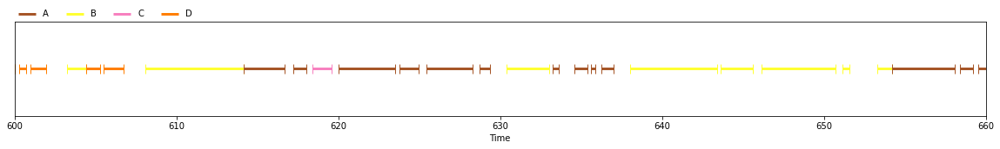

In [37]:
diarization

Evaluation

In [38]:
metric = DiarizationErrorRate()
der = metric(groundtruth, diarization)
print(f'diarization error rate = {100 * der:.1f}%')

/usr/local/lib/python3.7/dist-packages/pyannote/metrics/utils.py:184: UserWarning:

'uem' was approximated by the union of 'reference' and 'hypothesis' extents.



diarization error rate = 42.9%


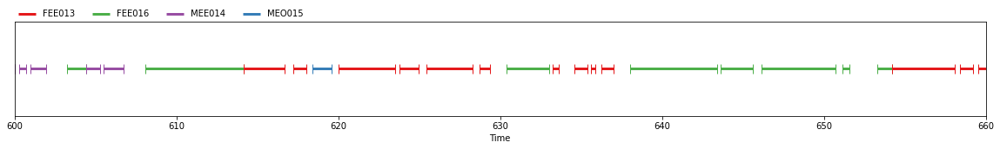

In [39]:
mapping = metric.optimal_mapping(groundtruth, diarization)
diarization.rename_labels(mapping=mapping)

## Speaker Diarization : Pipeline and evaluation with S4D

In [40]:
!pip install s4d

     |████████████████████████████████| 98 kB 3.9 MB/s 
     |████████████████████████████████| 38.1 MB 1.2 MB/s 
     |████████████████████████████████| 11.2 MB 39.6 MB/s 
     |████████████████████████████████| 11.3 MB 36.4 MB/s 
     |████████████████████████████████| 167 kB 51.4 MB/s 
     |████████████████████████████████| 890 kB 41.1 MB/s 
  Created wheel for s4d: filename=s4d-0.2.6-py3-none-any.whl size=120317 sha256=75d5d37c3f4947f1cae141b083506558e0b658511e312eb5e1930b2296368c0e
  Stored in directory: /root/.cache/pip/wheels/29/c8/69/c6aa1bf34364df97bb7511c395000d3473a23943b4bbe35b9f
  Created wheel for sidekit: filename=SIDEKIT-1.4.3.2-py3-none-any.whl size=203696 sha256=3253bc43f7c7e89f36ae2f817d1fcdab682725d71c702110fcbacb8191ae264b
  Stored in directory: /root/.cache/pip/wheels/ef/63/68/873d45814c5a4b94c10448afb319d9b6293eb1a567e1ccd25c
Successfully built s4d sidekit
  Attempting uninstall: scipy
    Found existing installation: scipy 1.4.1
    Uninstalling scipy-1.4.1:
  